Assignment 1
---
CIS 666, Spring 2021 <br>
Bradley Dowling <br>
2657649 <br>
---

For this project, I utilized standard library functions, Cython, Numpy, and Pillow. 
The standalone program, images.py, uses a command line interface created with the standard library module ArgParse.
Pillow is used only for image decoding and encoding. 
Numpy is used for multidimensional arrays.
Cython is used to improve the execution of the 2D convolution function.

In [2]:
from itertools import chain
import numpy as np
from PIL import Image

In [3]:
def get_image_data(filename, mode="L", dtype=np.uint8):
    """Return nupmy array from image file"""
    return np.asarray(Image.open(filename).convert(mode), dtype=dtype)

def get_new_image(outdata, mode):
    """Return new image from processed image data"""
    return Image.fromarray(outdata, mode)

### 1. Write a program to perform histogram equalization on a grayscale image.
---
    - Display the original and histogram equalized images.
    - Repeat the experiment for three different types: extreme dark, medium, and extreme light 

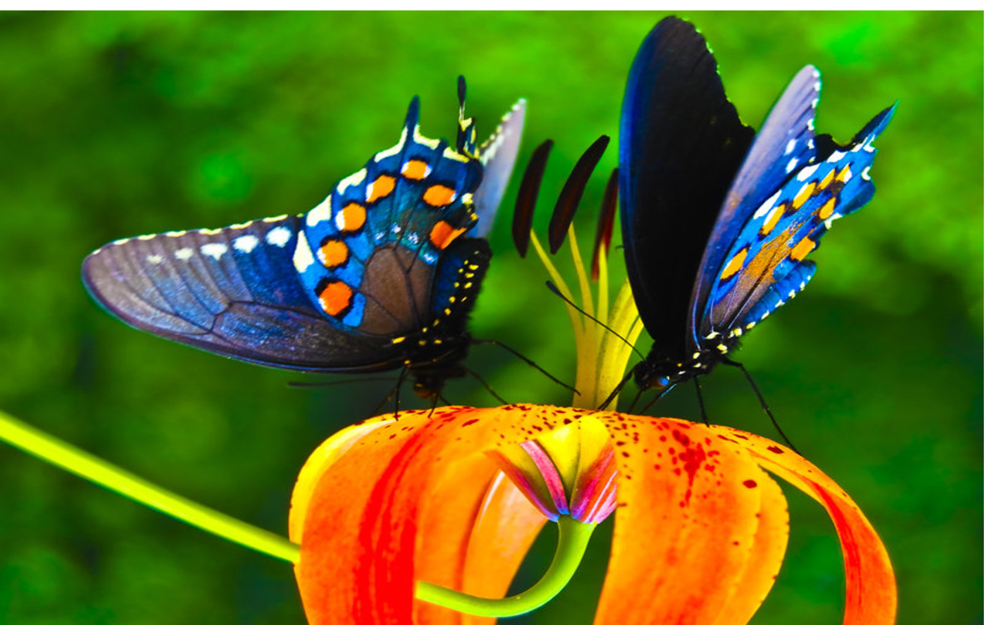

In [31]:
# First Image
LEVELS = 256 
indata = get_image_data("./pictures/butterflies.jpg", mode="L")

print("Original Color Image")
Image.open("./pictures/butterflies.jpg")

Grayscale Image


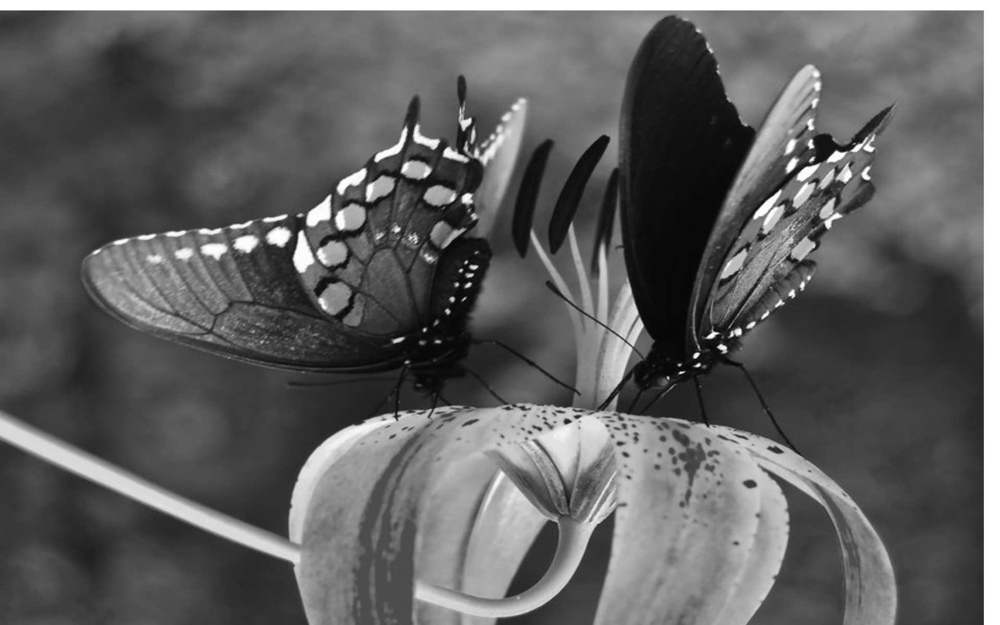

In [48]:
print("Grayscale Image")
Image.open("pictures/butterflies.jpg").convert("L")

To implement histogram equalization, I take a count of individual luminosity levels using the level as the index of an array, and compute the cumulative distribution function to equalize the original histogram:

In [32]:
def histogram(imgdata):
    """Returns a histogram of length 255 for a single channel"""
    histogram = [0] * LEVELS
    for pixel in imgdata.flatten():
        histogram[pixel] += 1
    return histogram

In [33]:
hist = histogram(indata)
print(hist[0:9], "...", hist[246:])

[0, 1, 4, 14, 40, 99, 271, 1252, 6475] ... [636, 663, 862, 985, 1206, 1530, 1512, 1049, 1068, 74517]


The cumulative distribution function is defined as $$cdf_{x}(i) = \sum_{j=0}^{i}\, p_{x} (x = j) $$

where $i$ represents the pixels in an image, $j$ is a given luminosity level, $x$ is a given pixel, and $p$ is the probability of an occurance of a particular pixel.

In [34]:
def cdf(histogram):
    """Returns the cumulative distribution of the image histogram"""
    cdf = [0] * LEVELS
    cdf[0] = histogram[0]
    for i in range(1, LEVELS):
        cdf[i] = cdf[i-1] + histogram[i]
    return cdf

In [35]:
imgcdf = cdf(hist)
print(imgcdf[0:9], "...", imgcdf[250:])

[0, 1, 5, 19, 59, 158, 429, 1681, 8156] ... [2224324, 2225854, 2227366, 2228415, 2229483, 2304000]


Verify that this CDF makes sense:

In [36]:
# Is the cumulative total equal to the dimensions of the image?
imgcdf[255] == indata.shape[0] * indata.shape[1]

True

To equalize the image, I use the general histogram equalization formula:

$$ h(v) = round(\frac{cdf(v) - cdf_{min}}{(M \times N) - cdf_{min}} \times (L - 1)) $$

Where $L$ corresponds to the global constant LEVELS, $M, N$ are the dimensions of the image, and $cdf_{min}$ is the nonzero minimum of the cumulative distribution function.


In [37]:
def equalize(cdf):
    """Linearize histogram based on CDF and normalize to [0, 255]"""
    nzmin = min(filter(lambda x: x > 0, cdf))
    if cdf[-1] - nzmin == 0:
        raise ValueError("Channel histogram cannot be equalized: Division by zero")
    return [round(((cdf[i] - nzmin) / (cdf[-1] - nzmin)) * (LEVELS - 1)) for i in range(LEVELS)]

In [38]:
imgeq = equalize(imgcdf)
print(imgeq[0:9], "...", imgeq[90:100], "...", imgeq[250:])

[0, 0, 0, 0, 0, 0, 0, 0, 1] ... [142, 144, 145, 146, 148, 149, 150, 151, 153, 154] ... [246, 246, 247, 247, 247, 255]


Next, transform the data by using the luminosity level of the pixels in the original image as the index into the equalized histogram, and rebuild the output image matrix from those values:

In [44]:
def transform_grayscale(imgeq, indata):
    """Return matrix of luminosity levels mapped from equalized histogram"""
    outdata = np.zeros_like(indata)
    for i in range(indata.shape[0]):
        for j in range(indata.shape[1]):
            outdata[i, j] = imgeq[indata[i, j]]
    return outdata

In [46]:
outdata = transform_grayscale(imgeq, indata)

Finally, reconstruct the image:

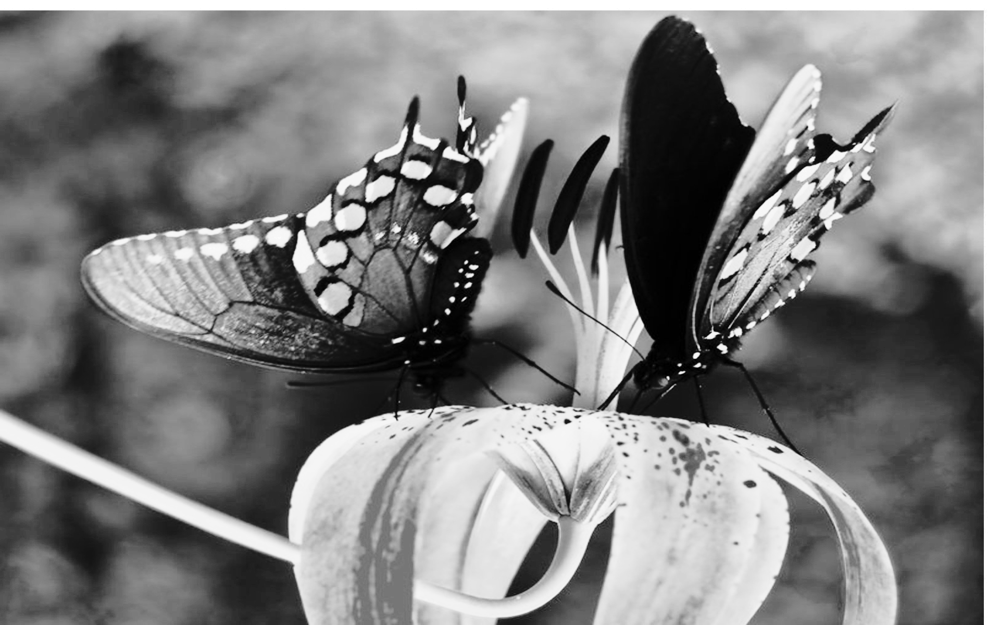

In [50]:
get_new_image(outdata, "L")

### Repeat for three different types: extreme dark, medium dark, extreme light
---

In [62]:
def hist_equalize(filename, mode="L"):
    indata = get_image_data(filename, mode)
    return get_new_image(transform_grayscale(equalize(cdf(histogram(indata))), indata), mode)

#### Extreme dark
---

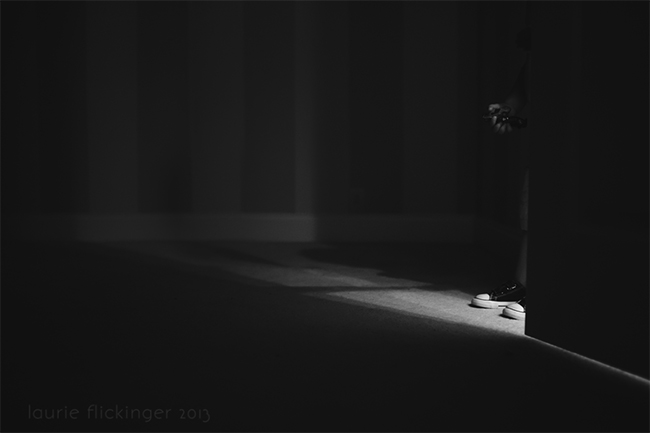

In [54]:
# Extreme Dark
Image.open("pictures/extreme_dark.jpg")

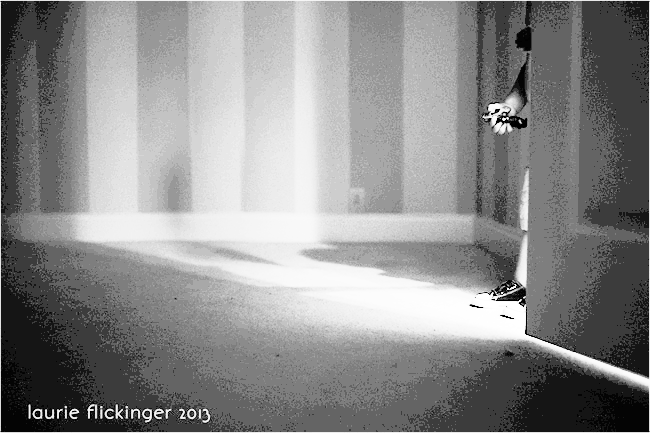

In [63]:
# Extreme Dark
hist_equalize("pictures/extreme_dark.jpg")

#### Medium Dark
---

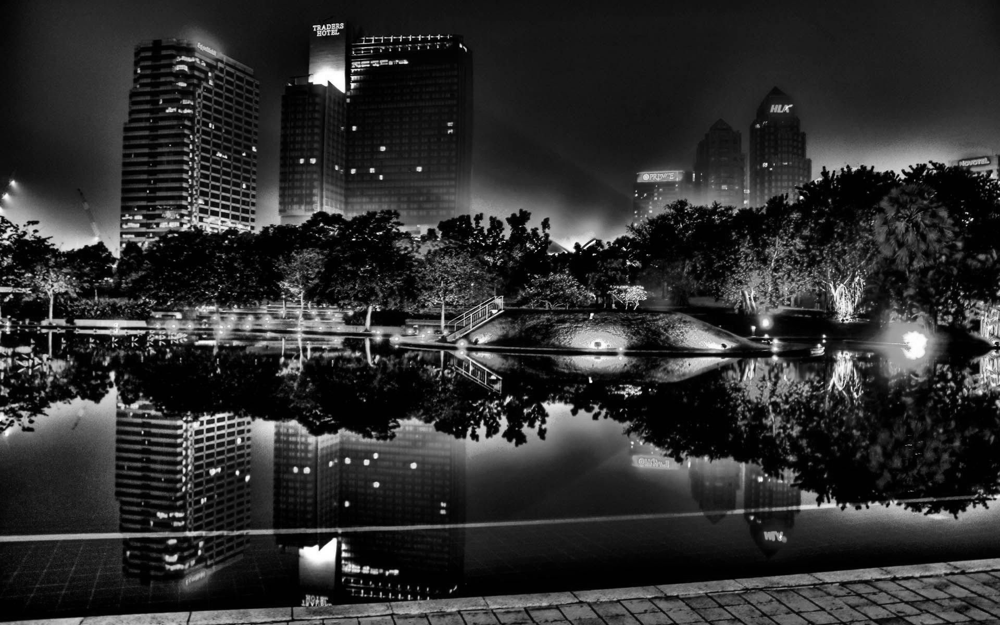

In [58]:
Image.open("pictures/colorcity.jpg").convert("L")

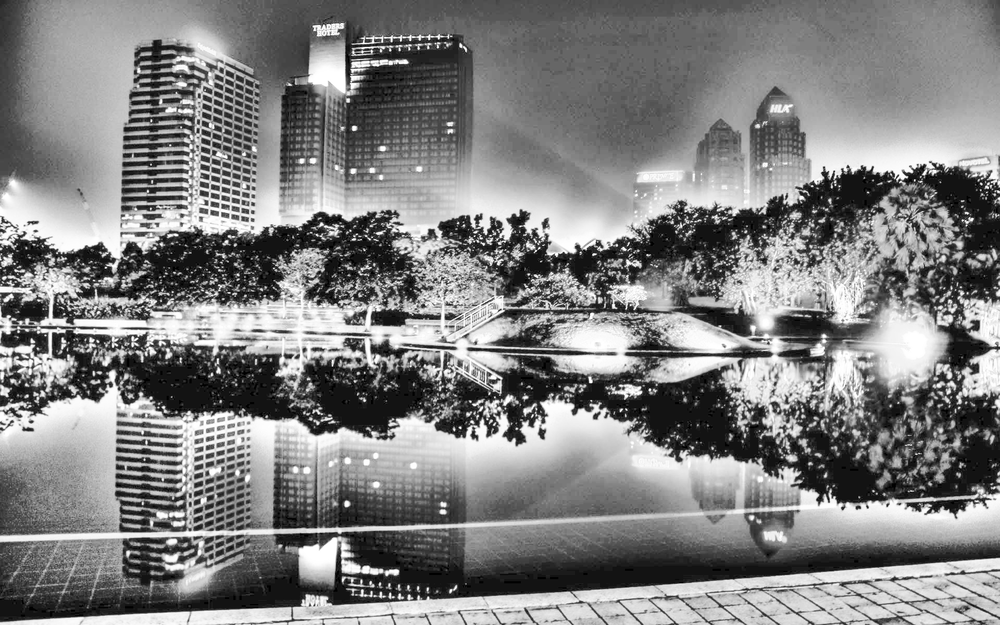

In [64]:
hist_equalize("pictures/colorcity.jpg")

#### Extreme Light
---

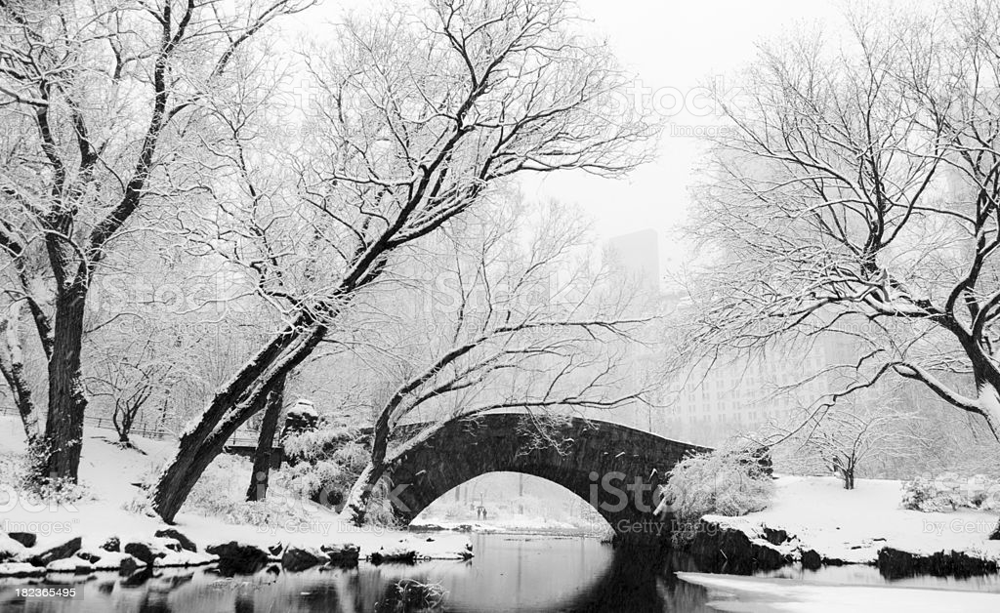

In [66]:
Image.open("pictures/extreme_light.jpg").convert("L")

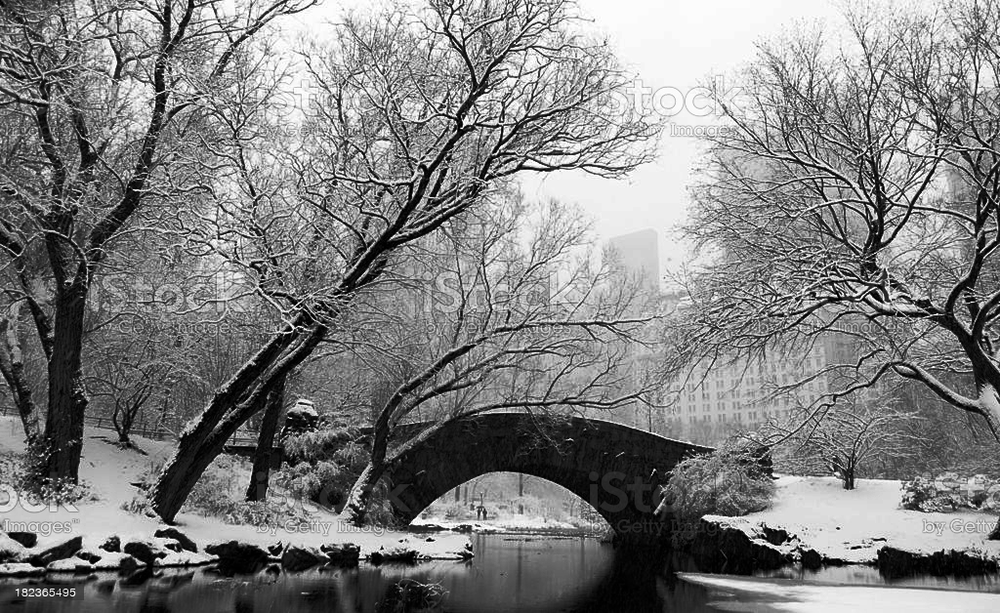

In [67]:
hist_equalize("pictures/extreme_light.jpg")

---
## 2. Write a program to perform histogram equalization on a color image.
---
   - Display the original and histogram-equalized images
   - Repeat for three image types: extreme dark, medium dark, and extreme light

For RGB images, the procedure is similar to grayscale, but we must perform the procedure on each channel. For HSV images, we can either manipulate all three channels to get some strange effects, or only apply the procedure to the Value channel. RGBA could be done in a similar fasion, but is not treated here.

In [80]:
def rgb_histogram(indata):
    red = [0] * LEVELS
    green = [0] * LEVELS
    blue = [0] * LEVELS
    for color in chain.from_iterable(indata):
        red[color[0]] += 1
        green[color[1]] += 1
        blue[color[2]] += 1
    return red, green, blue

In [70]:
def hsv_histogram(indata):
    value = [0] * LEVELS
    for i in chain.from_iterable(indata):
        value[i[2]] += 1
    return value

In [82]:
def rgb_cdf(rgb):
    return cdf(rgb[0]), cdf(rgb[1]), cdf(rgb[2])

In [83]:
def rgb_eq(rgb):
    return equalize(rgb[0]), equalize(rgb[1]), equalize(rgb[2])

In [91]:
def transform_rgb(rgbeq, indata):
    outdata = np.zeros_like(indata)
    for i in range(indata.shape[0]):
        for j in range(indata.shape[1]):
            outdata[i, j] = [
                rgbeq[0][indata[i, j, 0]],
                rgbeq[1][indata[i, j, 1]],
                rgbeq[2][indata[i, j, 2]]
            ]
    return outdata

In [95]:
def transform_hsv(hsveq, indata):
    outdata = np.zeros_like(indata)
    for i in range(indata.shape[0]):
        for j in range(indata.shape[1]):
            outdata[i, j] = [
                indata[i, j, 0],
                indata[i, j, 1],
                hsveq[indata[i, j, 2]]
            ]
    return outdata

In [97]:
def hist_eq_rgb(filename, mode="RGB"):
    indata = get_image_data(filename, mode)
    return transform_rgb(rgb_eq(rgb_cdf(rgb_histogram(indata))), indata)

def hist_eq_hsv(filename, mode="HSV"):
    indata = get_image_data(filename, mode)
    return transform_hsv(equalize(cdf(hsv_histogram(indata))), indata)

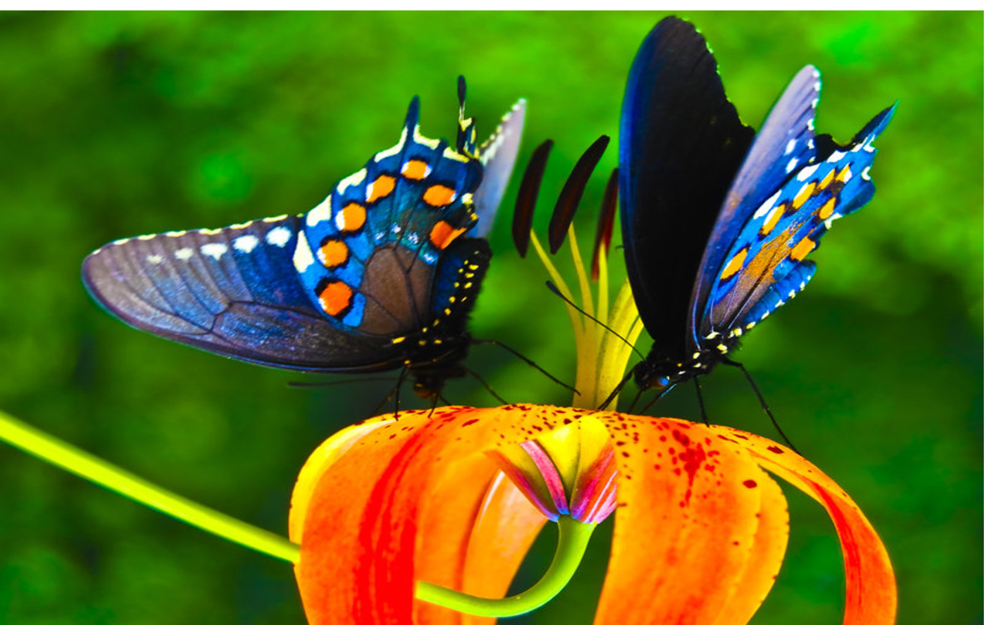

In [102]:
# Initial Image
f = "pictures/butterflies.jpg"
mode = "RGB"
Image.open(f)

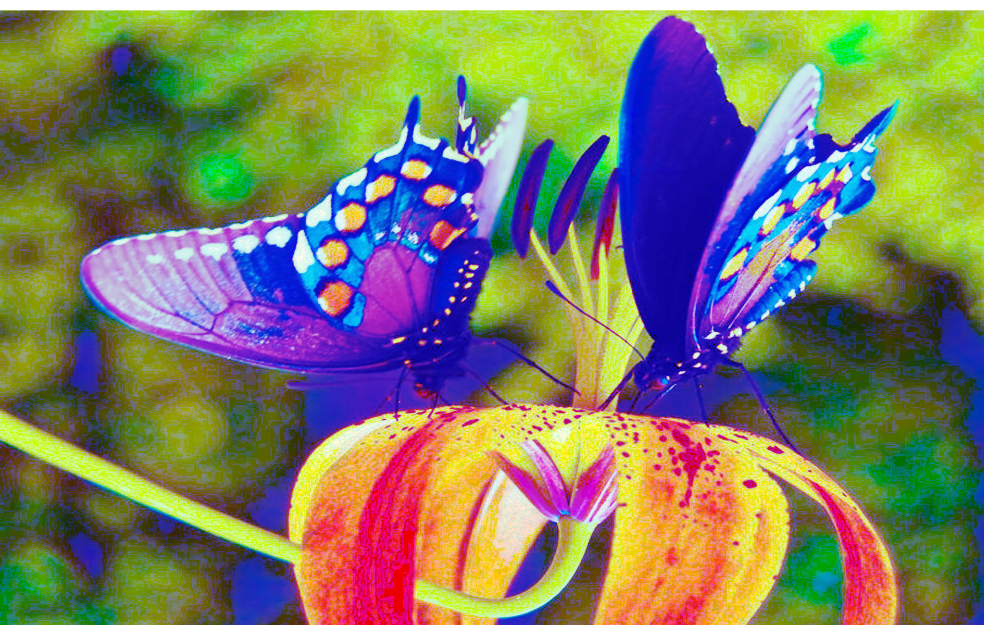

In [104]:
get_new_image(hist_eq_rgb(f), mode)

In [110]:
# Jupyter will not print this to the report, so this one will launch separately
mode = "HSV"
get_new_image(hist_eq_hsv(f, mode), mode).show()

In [111]:
# What if we apply the RGB process to the channels of an HSV image?
get_new_image(hist_eq_rgb(f, mode), mode).show()

#### Extreme Dark
---

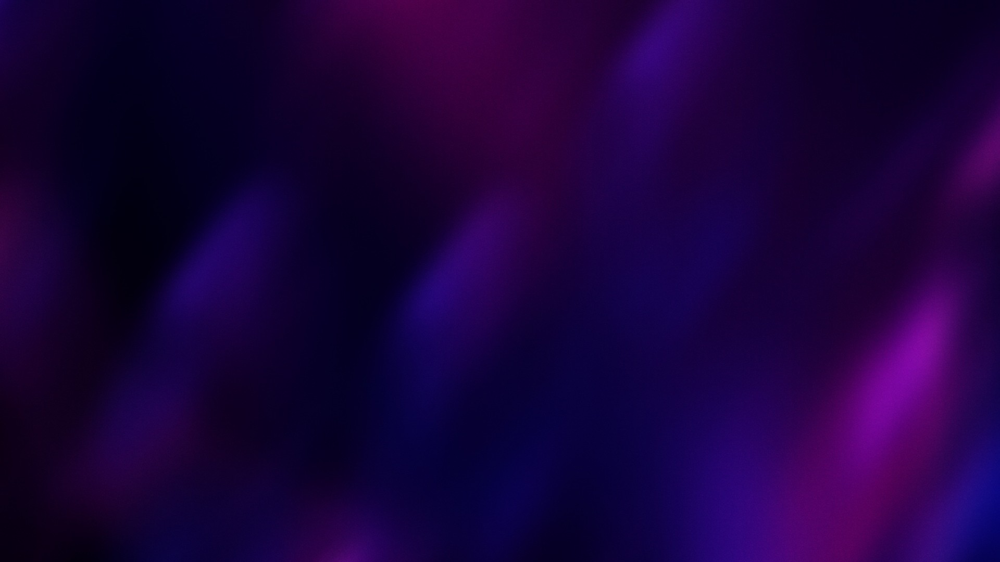

In [114]:
f = "pictures/extreme_dark_color.jpg"
mode = "RGB"
Image.open(f).convert(mode)

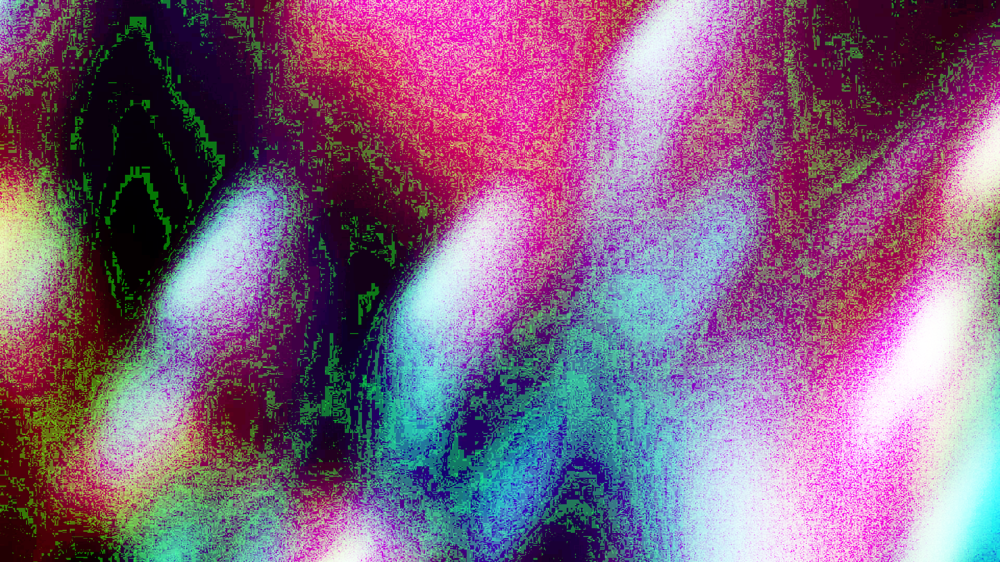

In [115]:
get_new_image(hist_eq_rgb(f, mode), mode)

In [118]:
mode = "HSV"
get_new_image(hist_eq_hsv(f, mode), mode).show()

In [119]:
get_new_image(hist_eq_rgb(f, mode), mode).show()

#### Medium Dark
---

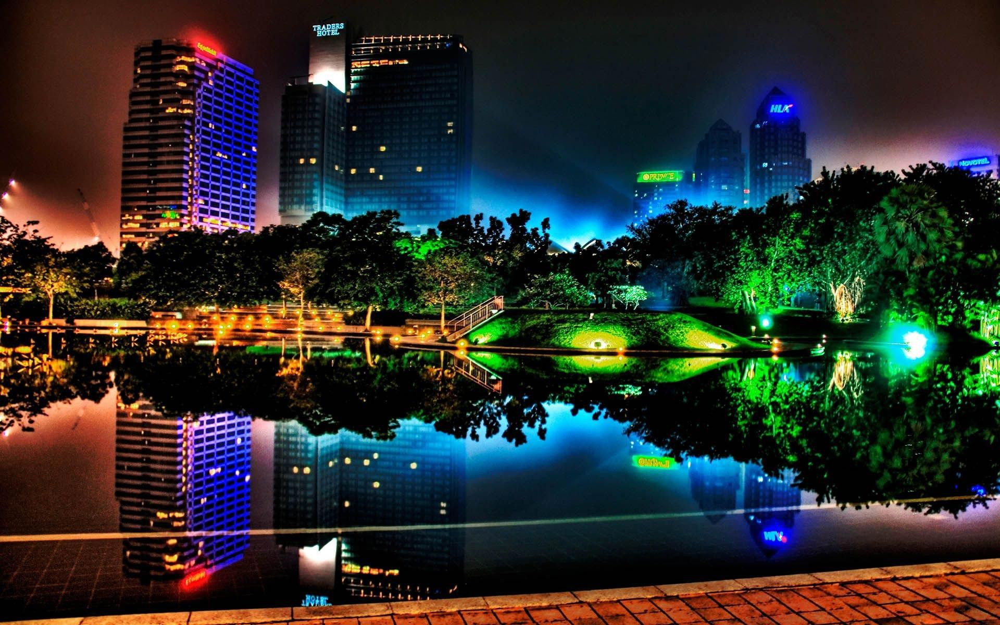

In [120]:
f = "pictures/colorcity.jpg"
mode = "RGB"
Image.open(f).convert(mode)

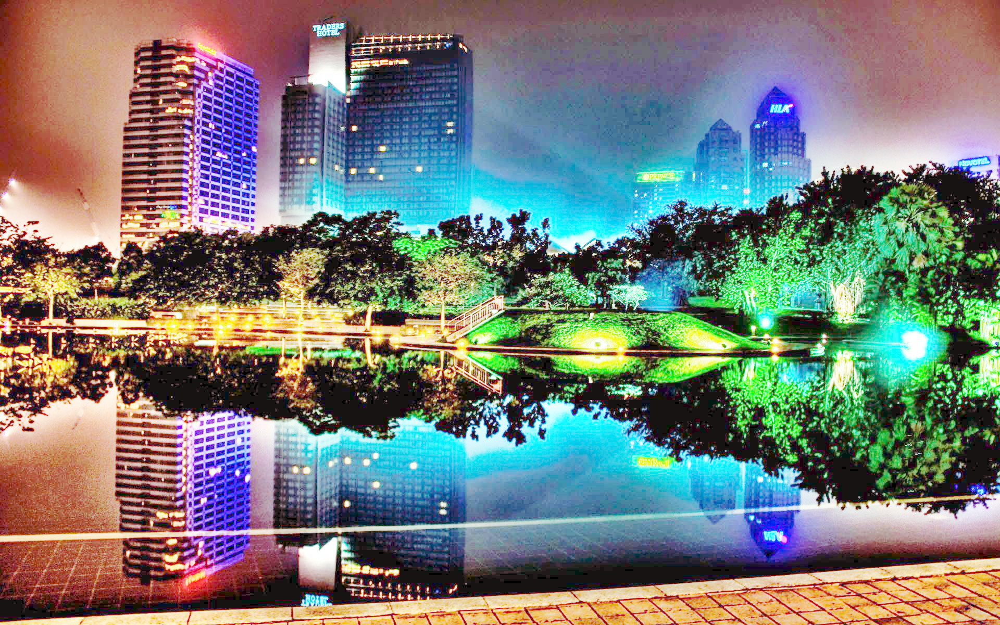

In [121]:
get_new_image(hist_eq_rgb(f, mode), mode)

In [123]:
mode = "HSV"
get_new_image(hist_eq_hsv(f, mode), mode).show()

In [124]:
get_new_image(hist_eq_rgb(f, mode), mode).show()

#### Extreme Light
---

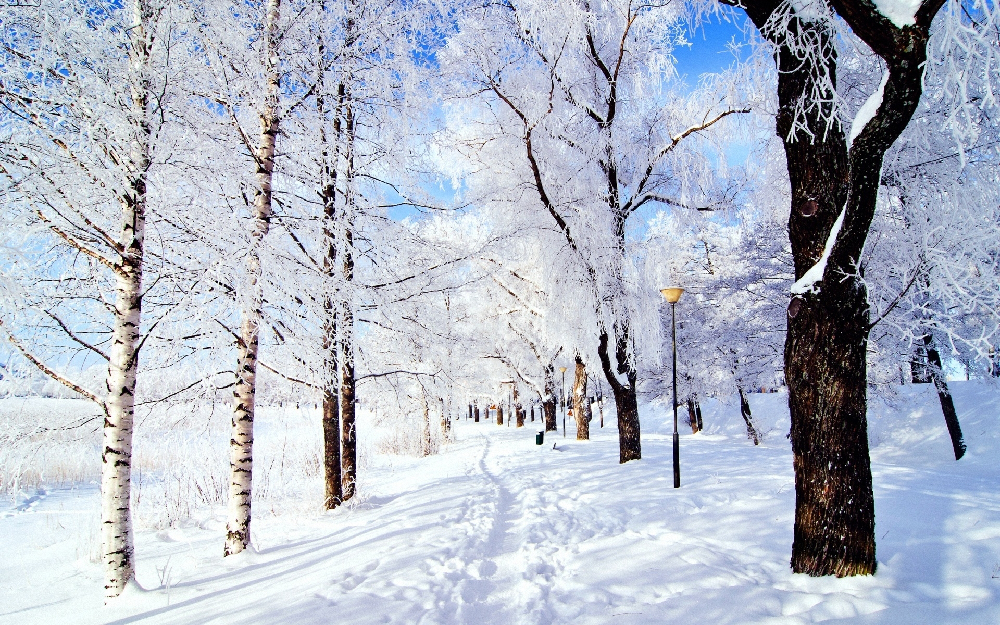

In [130]:
f = "pictures/extreme_light_rgb.jpg"
mode = "RGB"
Image.open(f).convert(mode)

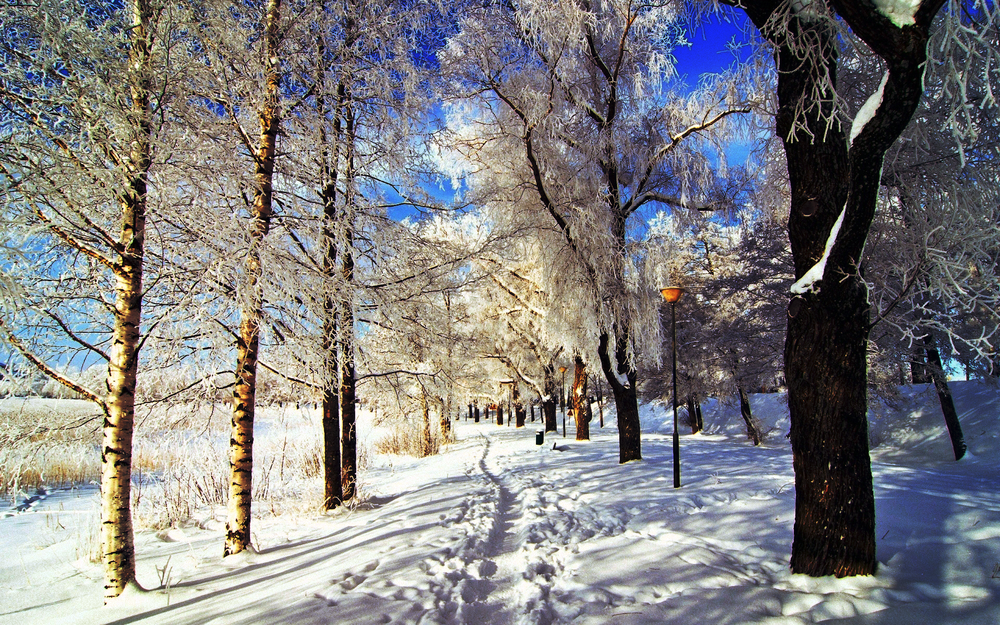

In [131]:
get_new_image(hist_eq_rgb(f, mode), mode)

In [132]:
mode = "HSV"
get_new_image(hist_eq_hsv(f, mode), mode).show()

In [133]:
get_new_image(hist_eq_rgb(f, mode), mode).show()

---
## 3: Write a program to find the image gradients of any gray scale image of your choice
---
   - Display the original, the gradient in x and y directions, and the gradient magnitude image.
   - Apply a simple threshold to the gradient magnitude image and display the gradient magnitude and the thresholding image. You may use 100 as you threshold value or any other appropriate value.

To compute the x, y gradients of the grayscale image, I convolve the images with well known filter operators, like the Sobel and Scharr filters. I implemented a naive convolution function, but in Python it was too slow. Using Cython, I added static types, kept types stable, and integrated the high performance arrays from numpy. I tested with OpenMP as well, but observed little difference. Cython is well supported in Jupyter environments.

In [ ]:
import 